In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import plotly.express as px
import seaborn as sns
%matplotlib inline
import copy


from sklearn.model_selection import train_test_split


from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn import metrics

In [2]:
data = pd.read_csv(input("Enter the path:"))

Enter the path:C:\Users\sunil\Desktop\ML project\regration project\Regression Projects\AIR QUALITY DATA.csv


In [3]:
data.head()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


In [4]:
def data_understand(data):
    print("\n","Name of the columns",data.columns)
    #lets check out the name of collumns
    print("\n","size of the detaset",data.shape)
      #lets check out the no. of size of detaset
    print("\n","understaning the detaset information",data.info())
      # understanding info
    return data.isnull().sum()
       # lets check missing values in dataset

In [5]:
data_understand(data)


 Name of the columns Index(['CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
       'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
       'T', 'RH', 'AH'],
      dtype='object')

 size of the detaset (66297, 13)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66297 entries, 0 to 66296
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   CO(GT)         65535 non-null  float64
 1   PT08.S1(CO)    65535 non-null  float64
 2   NMHC(GT)       65535 non-null  float64
 3   C6H6(GT)       65535 non-null  float64
 4   PT08.S2(NMHC)  65535 non-null  float64
 5   NOx(GT)        65535 non-null  float64
 6   PT08.S3(NOx)   65535 non-null  float64
 7   NO2(GT)        65535 non-null  float64
 8   PT08.S4(NO2)   65535 non-null  float64
 9   PT08.S5(O3)    65535 non-null  float64
 10  T              65535 non-null  float64
 11  RH             65535 non-null  float64
 12  AH             655

CO(GT)           762
PT08.S1(CO)      762
NMHC(GT)         762
C6H6(GT)         762
PT08.S2(NMHC)    762
NOx(GT)          762
PT08.S3(NOx)     762
NO2(GT)          762
PT08.S4(NO2)     762
PT08.S5(O3)      762
T                762
RH               762
AH               762
dtype: int64

## in above clearly show the missing values present

In [6]:

pd.set_option("display.max_rows",None)
pd.set_option("display.max_columns",None)
#Exploring dataset to findout which type of missing values are present
data.loc[9:100]

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
9,0.6,1010.0,19.0,1.7,561.0,-200.0,1705.0,-200.0,1235.0,501.0,10.3,60.2,0.7517
10,-200.0,1011.0,14.0,1.3,527.0,21.0,1818.0,34.0,1197.0,445.0,10.1,60.5,0.7465
11,0.7,1066.0,8.0,1.1,512.0,16.0,1918.0,28.0,1182.0,422.0,11.0,56.2,0.7366
12,0.7,1052.0,16.0,1.6,553.0,34.0,1738.0,48.0,1221.0,472.0,10.5,58.1,0.7353
13,1.1,1144.0,29.0,3.2,667.0,98.0,1490.0,82.0,1339.0,730.0,10.2,59.6,0.7417
14,2.0,1333.0,64.0,8.0,900.0,174.0,1136.0,112.0,1517.0,1102.0,10.8,57.4,0.7408
15,2.2,1351.0,87.0,9.5,960.0,129.0,1079.0,101.0,1583.0,1028.0,10.5,60.6,0.7691
16,1.7,1233.0,77.0,6.3,827.0,112.0,1218.0,98.0,1446.0,860.0,10.8,58.4,0.7552
17,1.5,1179.0,43.0,5.0,762.0,95.0,1328.0,92.0,1362.0,671.0,10.5,57.9,0.7352
18,1.6,1236.0,61.0,5.2,774.0,104.0,1301.0,95.0,1401.0,664.0,9.5,66.8,0.7951


In [7]:
## missing values imputation
def imputation(data):
    
    global df_impute
    
    from sklearn.impute import SimpleImputer
    
    df_impute = copy.deepcopy(data)
    
    impute_strategy = SimpleImputer(strategy = 'mean')
    df_impute = impute_strategy.fit_transform(df_impute)
    
    df_impute = pd.DataFrame(df_impute)
    
    df_impute.columns = data.columns

In [8]:
imputation(data)

In [9]:
df_impute.head(20)

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888
5,1.2,1197.0,38.0,4.7,750.0,89.0,1337.0,96.0,1393.0,949.0,11.2,59.2,0.7848
6,1.2,1185.0,31.0,3.6,690.0,62.0,1462.0,77.0,1333.0,733.0,11.3,56.8,0.7603
7,1.0,1136.0,31.0,3.3,672.0,62.0,1453.0,76.0,1333.0,730.0,10.7,60.0,0.7702
8,0.9,1094.0,24.0,2.3,609.0,45.0,1579.0,60.0,1276.0,620.0,10.7,59.7,0.7648
9,0.6,1010.0,19.0,1.7,561.0,-200.0,1705.0,-200.0,1235.0,501.0,10.3,60.2,0.7517


In [10]:
df_impute.isnull().sum()

CO(GT)           0
PT08.S1(CO)      0
NMHC(GT)         0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
dtype: int64

In [11]:
df_impute.corr(method = "pearson")

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
CO(GT),1.000000,0.040358,0.127145,-0.030751,0.030278,0.527675,-0.089916,0.672756,-0.071198,0.081223,-0.068259,-0.045962,-0.045174
PT08.S1(CO),0.040358,1.000000,0.169888,0.854233,0.932065,0.272499,0.094304,0.151556,0.845552,0.891289,0.757573,0.747490,0.767417
NMHC(GT),0.127145,0.169888,1.000000,0.039618,0.108318,-0.006183,0.054375,0.102942,0.160866,0.098397,0.003271,0.011962,0.016160
C6H6(GT),-0.030751,0.854233,0.039618,1.000000,0.768425,-0.003270,0.515052,-0.009588,0.775316,0.642712,0.971510,0.924936,0.984627
PT08.S2(NMHC),0.030278,0.932065,0.108318,0.768425,1.000000,0.326473,-0.068199,0.173764,0.875294,0.909334,0.670923,0.586413,0.648077
NOx(GT),0.527675,0.272499,-0.006183,-0.003270,0.326473,1.000000,-0.432598,0.815212,0.031610,0.458040,-0.139941,-0.053540,-0.097053
PT08.S3(NOx),-0.089916,0.094304,0.054375,0.515052,-0.068199,-0.432598,1.000000,-0.250167,0.125951,-0.202349,0.589613,0.575994,0.623677
NO2(GT),0.672756,0.151556,0.102942,-0.009588,0.173764,0.815212,-0.250167,1.000000,-0.022772,0.251083,-0.082013,-0.078646,-0.058111
PT08.S4(NO2),-0.071198,0.845552,0.160866,0.775316,0.875294,0.031610,0.125951,-0.022772,1.000000,0.723746,0.756369,0.640784,0.693047
PT08.S5(O3),0.081223,0.891289,0.098397,0.642712,0.909334,0.458040,-0.202349,0.251083,0.723746,1.000000,0.506225,0.526013,0.521544


In [12]:
## Discriptive statestics
df_impute.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
CO(GT),66297.0,-34.081958,77.102688,-200.0,0.600,1.500000,2.6000,11.900
PT08.S1(CO),66297.0,1048.958587,327.802153,-200.0,924.000,1050.000000,1218.0000,2040.000
NMHC(GT),66297.0,-159.665705,137.083807,-200.0,-200.000,-200.000000,-200.0000,1189.000
C6H6(GT),66297.0,1.838231,41.252857,-200.0,3.900,7.800000,13.6000,63.700
PT08.S2(NMHC),66297.0,895.146029,340.729231,-200.0,716.000,895.146029,1103.0000,2214.000
NOx(GT),66297.0,168.876448,255.198567,-200.0,52.000,144.000000,281.0000,1479.000
PT08.S3(NOx),66297.0,794.253925,319.773145,-200.0,640.000,794.253925,955.0000,2683.000
NO2(GT),66297.0,58.650156,125.674042,-200.0,54.000,96.000000,132.0000,340.000
PT08.S4(NO2),66297.0,1391.901411,465.208950,-200.0,1188.000,1442.000000,1662.0000,2775.000
PT08.S5(O3),66297.0,975.133181,453.836099,-200.0,703.000,948.000000,1250.0000,2523.000


In [13]:
## outlier detection using box plot method
for i in df_impute.columns:
    fig = px.box(df_impute , y=i, width= 600 , height= 400, title=i , template="plotly_dark")
    fig.show()

## the box plot shown some extream values

In [14]:
from scipy.stats import zscore

In [15]:
# Treatment on extream values using zscore
def multi_tretment_outlier(df_impute):   
    global data_z
    print("List of outliers")
    data_z= df_impute.apply(zscore) # find outlier using zscore 
    print(np.where(data_z > 3))
    feature_columns = df_impute.columns

    for i in feature_columns:   #tretment of outliers
        df_impute[i] = np.where(df_impute[i] > (df_impute[i].quantile(0.75) + (df_impute[i].quantile(0.75) - df_impute[i].quantile(0.25))*1.5),
                           (df_impute[i].quantile(0.75) + (df_impute[i].quantile(0.75) - df_impute[i].quantile(0.25))*1.5),
                          np.where(df_impute[i] < (df_impute[i].quantile(0.25) - (df_impute[i].quantile(0.75) - df_impute[i].quantile(0.25))*1.5),
                           (df_impute[i].quantile(0.25) - (df_impute[i].quantile(0.75) - df_impute[i].quantile(0.25))*1.5),df_impute[i]))
    for i in feature_columns:
        fig = px.box( df_impute, y= i, width=600, height=400, title=i, template="plotly_dark") 

        fig.show() 
    global data_z_1
    print(" Resolve outliers") 
    data_z_1= df_impute.apply(zscore)
    print(np.where(data_z_1 > 18)) ## treatment on extream value using z_score



In [16]:
multi_tretment_outlier(df_impute)

List of outliers
(array([   10,    11,    24, ..., 66211, 66228, 66255], dtype=int64), array([6, 6, 2, ..., 2, 5, 2], dtype=int64))


 Resolve outliers
(array([], dtype=int64), array([], dtype=int64))


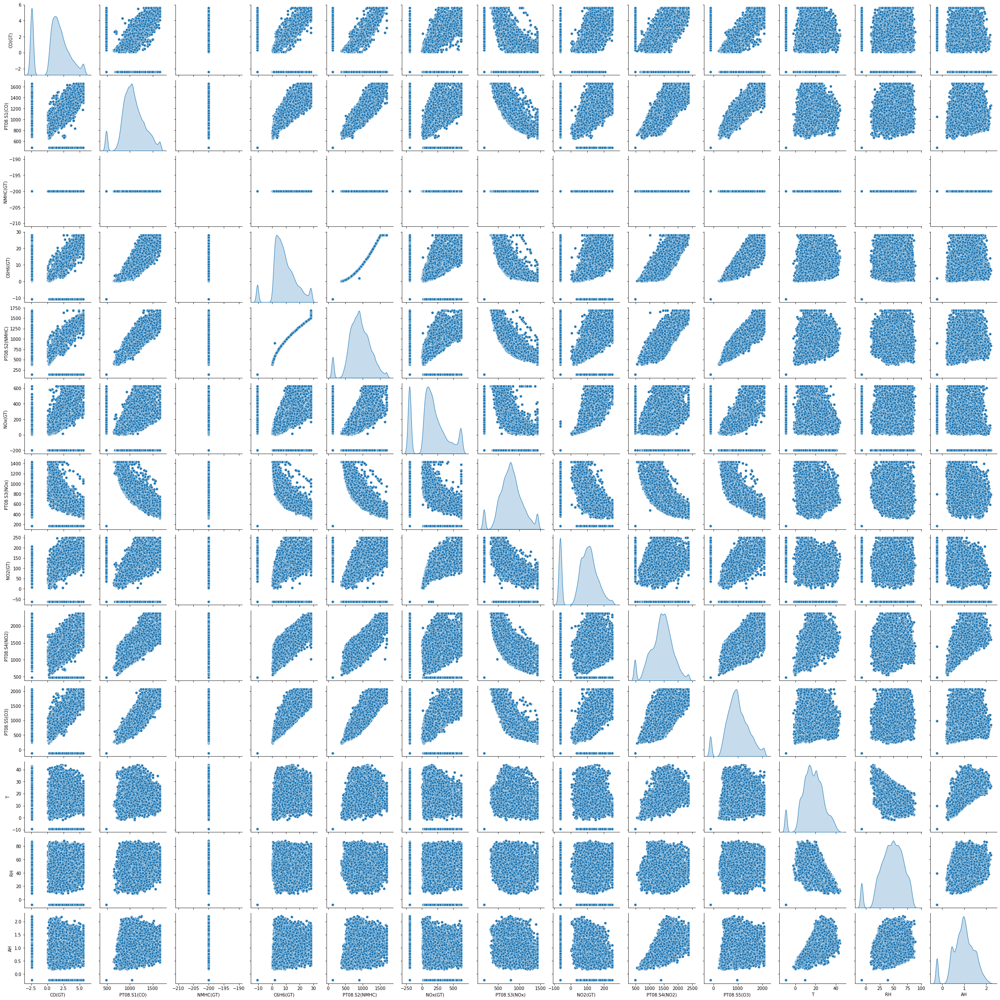

In [17]:
import seaborn as sns

sns.pairplot(df_impute, diag_kind = "kde")

In [18]:
df_impute.corr(method = "pearson")

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
CO(GT),1.000000,0.416666,NaN,0.418335,0.396469,0.776667,-0.411440,0.742926,0.193727,0.414923,-0.097185,-0.026810,-0.086572
PT08.S1(CO),0.416666,1.000000,NaN,0.912710,0.919525,0.412345,-0.367075,0.317091,0.757566,0.924187,0.301734,0.354828,0.355719
NMHC(GT),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
C6H6(GT),0.418335,0.912710,NaN,1.000000,0.986825,0.381012,-0.343185,0.284597,0.822171,0.901102,0.429727,0.223723,0.404222
PT08.S2(NMHC),0.396469,0.919525,NaN,0.986825,1.000000,0.380009,-0.367160,0.290891,0.832892,0.911154,0.451135,0.211899,0.396400
NOx(GT),0.776667,0.412345,NaN,0.381012,0.380009,1.000000,-0.481499,0.897519,0.059382,0.460877,-0.236220,0.038121,-0.212020
PT08.S3(NOx),-0.411440,-0.367075,NaN,-0.343185,-0.367160,-0.481499,1.000000,-0.382400,-0.180125,-0.384933,0.150657,0.217865,0.081129
NO2(GT),0.742926,0.317091,NaN,0.284597,0.290891,0.897519,-0.382400,1.000000,0.012268,0.348783,-0.168921,-0.111953,-0.266761
PT08.S4(NO2),0.193727,0.757566,NaN,0.822171,0.832892,0.059382,-0.180125,0.012268,1.000000,0.690638,0.678001,0.240447,0.703530
PT08.S5(O3),0.414923,0.924187,NaN,0.901102,0.911154,0.460877,-0.384933,0.348783,0.690638,1.000000,0.245044,0.359997,0.306264


In [19]:
df_impute.corr(method = "pearson") > 0.9

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
CO(GT),True,False,False,False,False,False,False,False,False,False,False,False,False
PT08.S1(CO),False,True,False,True,True,False,False,False,False,True,False,False,False
NMHC(GT),False,False,False,False,False,False,False,False,False,False,False,False,False
C6H6(GT),False,True,False,True,True,False,False,False,False,True,False,False,False
PT08.S2(NMHC),False,True,False,True,True,False,False,False,False,True,False,False,False
NOx(GT),False,False,False,False,False,True,False,False,False,False,False,False,False
PT08.S3(NOx),False,False,False,False,False,False,True,False,False,False,False,False,False
NO2(GT),False,False,False,False,False,False,False,True,False,False,False,False,False
PT08.S4(NO2),False,False,False,False,False,False,False,False,True,False,False,False,False
PT08.S5(O3),False,True,False,True,True,False,False,False,False,True,False,False,False


<AxesSubplot:>

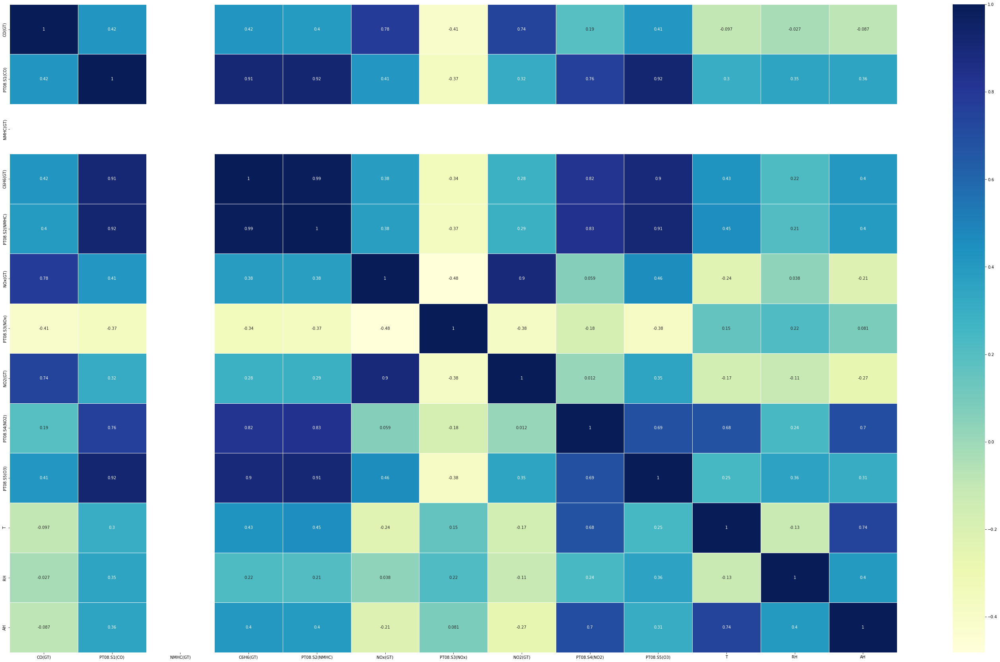

In [20]:
import matplotlib.pyplot as plt 
    

fig, ax = plt.subplots(figsize=(50,30)) 


sns.heatmap(df_impute.corr(method = "pearson"), annot = True, cmap="YlGnBu", linewidths=.5, ax=ax)

## in heat map show NMHC(GT) highly negative corelation so drop it

In [21]:

df_impute=df_impute.drop('NMHC(GT)', axis=1)



## train & test split

In [22]:
X = df_impute.drop('AH',axis=1)

                                                                    
Y = df_impute['AH']

In [23]:
X_train,X_test,y_train,y_test=train_test_split(X,Y,test_size=0.3,random_state=3)

In [24]:
X_train.head()

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH
60401,5.1,1512.0,27.1,1482.0,308.0,596.0,118.0,2189.0,1605.0,9.9,64.3
48660,3.5,1316.0,13.7,1105.0,624.5,511.0,199.0,1372.0,1828.0,11.7,49.3
59371,3.4,1384.0,23.5,1391.0,228.0,552.0,102.0,2316.0,1548.0,24.7,49.5
58384,2.5,1195.0,10.7,1004.0,387.0,652.0,193.0,1078.0,1421.0,5.2,44.2
44946,1.7,1084.0,10.7,1004.0,90.0,706.0,107.0,1761.0,839.0,35.6,29.2


## multiple regression

In [25]:
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [26]:
lr.score(X_train, y_train)

0.925081111174354

In [27]:
lr.score(X_test, y_test)

0.9261161667278088

In [28]:
coeff_df = pd.DataFrame(lr.coef_, X_train.columns, columns=['Coefficient'])  
coeff_df

,Coefficient
CO(GT),0.007675
PT08.S1(CO),-0.000301
C6H6(GT),0.054544
PT08.S2(NMHC),-0.002167
NOx(GT),0.000118
PT08.S3(NOx),-0.000630
NO2(GT),-0.000531
PT08.S4(NO2),0.000438
PT08.S5(O3),0.000053
T,0.042399


In [29]:
y_pred = lr.predict(X_test)

In [30]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 0.09761951718440023
Mean Squared Error: 0.01707588725367473
Root Mean Squared Error: 0.1306747383914532


## polynomial

In [31]:
from sklearn.preprocessing import PolynomialFeatures 

In [32]:
poly_features= PolynomialFeatures(degree=2)                       # second order polynomial regression

poly_features.fit(X_train)                                       # TRAIN = fit_transform

X_train_poly = poly_features.transform(X_train)                  # x_train_poly = poly_features.fit_transform(X_train)
X_test_poly =  poly_features.transform(X_test)     

## scaling

In [53]:
from sklearn.preprocessing import StandardScaler

In [54]:
scale = StandardScaler()
scale.fit(X_train_poly)
x_train_scale = scale.transform(X_train_poly)

x_test_scale = scale.transform(X_test_poly)

x_train_scale[:1]

array([[ 0.        ,  1.78592861,  1.83031699,  2.28459056,  1.9051115 ,
         0.65784524, -0.78619444,  0.45600086,  2.00392345,  1.41450596,
        -0.72056143,  0.86386195,  2.90183357,  2.24305099,  3.01507689,
         2.42105644,  1.20511248,  1.47731092,  1.34726917,  2.52968061,
         2.18153549,  0.68884693,  2.33436423,  2.04853322,  2.67189882,
         2.2402018 ,  0.93252488,  0.29182837,  0.85506781,  2.44401833,
         1.7900918 , -0.3786936 ,  1.7857134 ,  3.16821752,  2.7519339 ,
         1.4603732 ,  2.44519255,  1.5831327 ,  2.95543028,  2.46235789,
         0.45407888,  3.17516182,  2.30564962,  1.06055433,  1.03522552,
         1.02851194,  2.50640951,  1.96761925, -0.21330095,  2.30394438,
         0.16917724,  0.56871252,  0.21976335,  1.23061232,  0.87355478,
         0.21152995,  0.93001226, -0.81536446,  0.21657895,  0.52287845,
         0.97225305, -0.99368506, -0.02331067,  0.07864448,  1.14140858,
         0.86221507, -0.06280816,  0.90721665,  2.4

## polynomial regression

In [55]:
lr.fit(x_train_scale, y_train)

y_pred = lr.predict(x_test_scale)

In [56]:
lr.score(x_train_scale, y_train)


0.9966127524796036

In [57]:
lr.score(x_test_scale, y_test)

0.9966261172146776

In [58]:
coeff_used_000 = np.sum(lr.coef_ != 0)

coeff_used_000

78

In [59]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 0.020099912933331326
Mean Squared Error: 0.0007797652002845237
Root Mean Squared Error: 0.027924276181926787


## polynomial shown good score as compair to other so use this model 

### cross validation

In [60]:
from sklearn.model_selection import GridSearchCV, KFold, cross_val_score

In [61]:
cv_score = cross_val_score(lr, x_train_scale, y_train, scoring= "neg_mean_absolute_error", cv=KFold(n_splits=10))

In [62]:
cv_score

array([-0.02046701, -0.02033537, -0.02010242, -0.02074725, -0.02013046,
       -0.02035594, -0.02075737, -0.0200885 , -0.01961474, -0.01998091])

In [63]:
cv_score.min()

-0.020757369656833734

In [64]:
cv_score.max()

-0.019614741497589284

In [65]:
mean = cv_score.mean()
std =cv_score.std()
n = 10
sqrt_n= (n-1)**0.5

z_score_95=1.96

margin_of_error = (std/sqrt_n)*z_score_95

lcl_cv = mean - margin_of_error
ucl_cv = mean + margin_of_error

print("CV_LCL:",abs(lcl_cv))
print(" ")
print("CV_Ucl:",abs(ucl_cv))

CV_LCL: 0.020475447145986394
 
CV_Ucl: 0.020040549100713834


## hyper parameter tuning of 'alpha'

In [66]:
from sklearn.model_selection import GridSearchCV, KFold, cross_val_score


In [67]:
ridge = Ridge()

reg_param = [.0001, .001, .01, .1, 1, 10, 100, 1000]

hyper_grid = dict(alpha = reg_param)

grid_rr = GridSearchCV(estimator = ridge, param_grid = hyper_grid, scoring = "neg_mean_absolute_error", 
                      verbose = 1, n_jobs = -1, cv = 10)

grid_result = grid_rr.fit(x_train_scale, y_train)

print("Best_Score: ", grid_result.best_score_)

print(" ")

print("Best Alpha: ", grid_result.best_params_)

Fitting 10 folds for each of 8 candidates, totalling 80 fits
Best_Score:  -0.020253078699496236
 
Best Alpha:  {'alpha': 0.01}


In [77]:
ridge = Ridge()

reg_param = [.01, .02, .03, .04, .05, .06, .07, .08, .09,]

hyper_grid = dict(alpha = reg_param)

grid_rr = GridSearchCV(estimator = ridge, param_grid = hyper_grid, scoring = "neg_mean_absolute_error", 
                      verbose = 1, n_jobs = -1, cv = 10)

grid_result = grid_rr.fit(x_train_scale, y_train)

print("Best_Score: ", grid_result.best_score_)

print(" ")

print("Best Alpha: ", grid_result.best_params_)

Fitting 10 folds for each of 9 candidates, totalling 90 fits
Best_Score:  -0.020253078699496236
 
Best Alpha:  {'alpha': 0.01}


In [78]:
ridge_final = Ridge(alpha = 0.01)


cv_score_ridge = cross_val_score(ridge_final, x_train_scale, y_train, scoring = "neg_mean_absolute_error", cv = KFold(n_splits = 10))

In [79]:
cv_score_ridge

array([-0.02045514, -0.02033589, -0.02009045, -0.02073807, -0.02013304,
       -0.02034958, -0.02075595, -0.02006935, -0.01961765, -0.01998566])

##  dimention reduction

In [72]:


from sklearn.decomposition import FactorAnalysis

## factor analysis

In [73]:
fa = FactorAnalysis(n_components = 11) 

In [74]:
x_train_factor = fa.fit_transform(x_train_scale)

x_test_factor = fa.transform(x_test_scale)

c:\python37\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:ylabel='Density'>

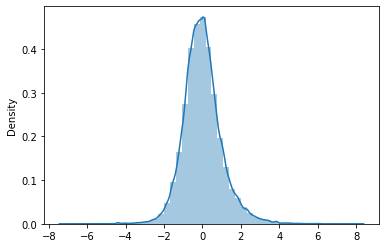

In [75]:
sns.distplot(x_train_factor)

## its a log normal disrtibution

## Linear Regression

In [43]:
lr = LinearRegression()

lr.fit(x_train_factor, y_train)



LinearRegression()

In [44]:
lr.score(x_train_factor, y_train)

0.906718676038099

In [45]:
lr.score(x_test_factor, y_test)

0.9064214601279547

In [46]:
coeff_df = pd.DataFrame(lr.coef_, X_train.columns, columns=['Coefficient'])  
coeff_df

,Coefficient
CO(GT),0.146223
PT08.S1(CO),0.284749
C6H6(GT),-0.102332
PT08.S2(NMHC),-0.142681
NOx(GT),-0.104342
PT08.S3(NOx),0.103299
NO2(GT),-0.137729
PT08.S4(NO2),-0.142634
PT08.S5(O3),-0.003023
T,-0.096949


In [47]:
y_pred = lr.predict(x_test_factor)                                        

In [48]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 0.10337209444333641
Mean Squared Error: 0.021627689380052693
Root Mean Squared Error: 0.14706355558075118


### Ridge Regularized Polynomial Regression

In [49]:
rr = Ridge(alpha = 0.5)                                                   # alpha = regularization parameter

rr.fit(X_train_poly, y_train)



y_pred_rr_poly = rr.predict(X_test_poly)

print("Ridge Regression Train Score: ", rr.score(X_train_poly, y_train))

print("Ridge Regression Test Score: ", rr.score(X_test_poly, y_test))

print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred_rr_poly))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred_rr_poly))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred_rr_poly)))

Ridge Regression Train Score:  0.9966127359698655
Ridge Regression Test Score:  0.9966262041016983
Mean Absolute Error: 0.020099291913378038
Mean Squared Error: 0.0007797451191260033
Root Mean Squared Error: 0.027923916615081118


c:\python37\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning:

Ill-conditioned matrix (rcond=1.36895e-18): result may not be accurate.



### LASSO Regularized Polynomial Regression

In [67]:
lasso_001 = Lasso(alpha = 0.5 , max_iter=10e5)

lasso_001.fit(X_train_poly , y_train)


y_pred_lasso_poly = lasso_001.predict(X_test_poly)

print("LASSO Regression Train Score: ", lasso_001.score(X_train_poly , y_train))

print("LASSO Regression Test Score: ", lasso_001.score(X_test_poly , y_test))


print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred_lasso_poly))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred_lasso_poly))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred_lasso_poly)))

LASSO Regression Train Score:  0.990632335594406
LASSO Regression Test Score:  0.9905079565900954
Mean Absolute Error: 0.03194367124878158
Mean Squared Error: 0.0021937825353130886
Root Mean Squared Error: 0.046837832308008115
